# Transfer learning with TF

Transfer learning can be used to work on exisiting models on same kind of problems.

- Can leverage the architecture used in the model for our own problem.
- Exisiting model with freezed weights can be directly used on the data.

In [1]:
!nvidia-smi

Fri Aug 23 13:03:30 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

## Get the data ready

In [2]:
import zipfile

!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip

--2024-08-23 13:03:33--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 172.253.117.207, 142.250.99.207, 74.125.20.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.253.117.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168546183 (161M) [application/zip]
Saving to: ‘10_food_classes_10_percent.zip.1’

10_food_classes_10_ 100%[===================>] 160.74M   204MB/s    in 0.8s    

2024-08-23 13:03:34 (204 MB/s) - ‘10_food_classes_10_percent.zip.1’ saved [168546183/168546183]



In [3]:
zip_ref = zipfile.ZipFile("/content/10_food_classes_10_percent.zip")
zip_ref.extractall()
zip_ref.close()

In [4]:
import os

def walk_through_dir(dir_path):
    for dirpath, dirnames, filenames in os.walk(dir_path):
        print(f"There are {len(dirnames)} directories and {len(filenames)} images in {dirpath}")

In [ ]:
walk_through_dir("10_food_classes_10_percent")

There are 2 directories and 0 images in 10_food_classes_10_percent
There are 10 directories and 0 images in 10_food_classes_10_percent/test
There are 0 directories and 250 images in 10_food_classes_10_percent/test/ice_cream
There are 0 directories and 250 images in 10_food_classes_10_percent/test/chicken_curry
There are 0 directories and 250 images in 10_food_classes_10_percent/test/sushi
There are 0 directories and 250 images in 10_food_classes_10_percent/test/steak
There are 0 directories and 250 images in 10_food_classes_10_percent/test/fried_rice
There are 0 directories and 250 images in 10_food_classes_10_percent/test/ramen
There are 0 directories and 250 images in 10_food_classes_10_percent/test/pizza
There are 0 directories and 250 images in 10_food_classes_10_percent/test/grilled_salmon
There are 0 directories and 250 images in 10_food_classes_10_percent/test/hamburger
There are 0 directories and 250 images in 10_food_classes_10_percent/test/chicken_wings
There are 10 directori

## Creating data loaders (preparing the data)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMAGE_SHAPE = (224, 224)
BATCH_SIZE = 32

train_dir = "10_food_classes_10_percent/train/"
test_dir = "10_food_classes_10_percent/test/"

train_datagen = ImageDataGenerator(rescale=1/255.)
test_datagen = ImageDataGenerator(rescale=1/255.)

print("Training images:")
train_data = train_datagen.flow_from_directory(train_dir,
                                               target_size=IMAGE_SHAPE,
                                               batch_size=BATCH_SIZE,
                                               class_mode="categorical")

print("Testing images:")
test_data = train_datagen.flow_from_directory(test_dir,
                                              target_size=IMAGE_SHAPE,
                                              batch_size=BATCH_SIZE,
                                              class_mode="categorical")

Training images:
Found 750 images belonging to 10 classes.
Testing images:
Found 2500 images belonging to 10 classes.


## Setting up callbacks

We'll be using three callbacks

- `tensorboard` track the model experiments.
- `ModelCheckpoint` for model checkpoint (Callback to save the Keras model or model weights at some frequency)
- `EarlyStopping` to prevent model from overfitting

In [5]:
import datetime

def create_tb_callback(dir_name, experiment_name):
    log_dir = dir_name + '/' + experiment_name + '/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir)
    print(f"Saving tensorboard log files to: {log_dir}")
    return tensorboard_callback

## Creating models using TFHub



In [6]:
import tensorflow as tf

## Creating and testing ResNet TFHub Feature Extraction Model

In [ ]:
resnet_model = tf.keras.applications.ResNet50V2(include_top=False,
                                                weights='imagenet',
                                                input_shape=IMAGE_SHAPE + (3,))

resnet_model.trainable = False

model_1 = tf.keras.Sequential([
    resnet_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(10, activation='softmax')
])

94668760/94668760 ━━━━━━━━━━━━━━━━━━━━ 6s 0us/step


In [ ]:
resnet_model.summary()

Model: "resnet50v2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 56, 56, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 56, 56, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 58, 58, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_preact_r… │
│ (Conv2D)             

 Total params: 23,564,800 (89.89 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 23,564,800 (89.89 MB)

In [ ]:
model_1.compile(
    loss = 'categorical_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

history_r1 = model_1.fit(train_data,
                         epochs = 5,
                         validation_data = test_data,
                         callbacks = [create_tb_callback('tb_callback', 'exp_r1')])

Saving tensorboard log files to: tb_callback/exp_r1/20240818-093635
Epoch 1/5


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


24/24 ━━━━━━━━━━━━━━━━━━━━ 36s 896ms/step - accuracy: 0.2312 - loss: 2.2878 - val_accuracy: 0.6212 - val_loss: 1.2243
Epoch 2/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 13s 527ms/step - accuracy: 0.7098 - loss: 1.0113 - val_accuracy: 0.7152 - val_loss: 0.8940
Epoch 3/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 423ms/step - accuracy: 0.8091 - loss: 0.6732 - val_accuracy: 0.7372 - val_loss: 0.8075
Epoch 4/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 24s 559ms/step - accuracy: 0.8575 - loss: 0.5440 - val_accuracy: 0.7436 - val_loss: 0.7679
Epoch 5/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 17s 427ms/step - accuracy: 0.8875 - loss: 0.4466 - val_accuracy: 0.7568 - val_loss: 0.7355


In [7]:
import pandas as pd
import matplotlib.pyplot as plt
def plot_history(history):
    history = pd.DataFrame(history.history)
    fig, ax = plt.subplots(1, 2, figsize=(12, 7))
    ax[0].plot(history['loss'], label = 'loss', c = 'blue')
    ax[0].plot(history['val_loss'], label = 'val-loss', c = 'orange')
    ax[0].set_title('model-loss')
    ax[0].set_xlabel('epoch')
    ax[0].set_ylabel('loss')
    ax[0].legend()
    ax[1].plot(history['accuracy'], label = 'accuracy', c = 'blue')
    ax[1].plot(history['val_accuracy'], label = 'val-accuracy', c = 'orange')
    ax[1].set_title('model-accuracy')
    ax[1].set_xlabel('epoch')
    ax[1].set_ylabel('accuracy')
    ax[1].legend()
    plt.show()
    plt.clf()
    plt.close()

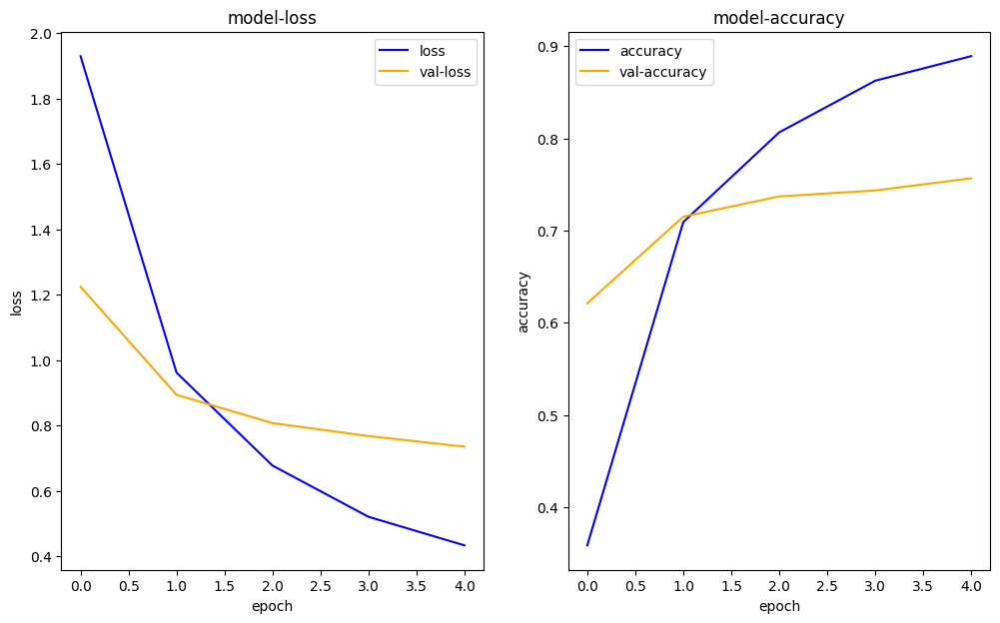

In [ ]:
plot_history(history_r1)

In [ ]:
model_1.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ resnet50v2 (Functional)              │ (None, 7, 7, 2048)          │      23,564,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d             │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 10)                  │          20,490 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 23,626,272 (90.13 MB)

 Trainable params: 20,490 (80.04 KB)

 Non-trainable params: 23,564,800 (89.89 MB)

 Optimizer params: 40,982 (160.09 KB)

## Creating and testing EfficientNet TFHub Feature Extraction Model

In [ ]:
efficentnet_model = tf.keras.applications.EfficientNetB3(include_top=False)

efficentnet_model.trainable = False

model_2 = tf.keras.Sequential([
    tf.keras.layers.Input(shape=IMAGE_SHAPE + (3,)),
    efficentnet_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(10, activation='softmax')
])

model_2.compile(
    loss = 'categorical_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

43941136/43941136 ━━━━━━━━━━━━━━━━━━━━ 4s 0us/step


In [ ]:
history_e1 = model_2.fit(train_data,
                         epochs = 5,
                         validation_data = test_data,
                         callbacks = [create_tb_callback('tb_callback', 'exp_e1')])

Saving tensorboard log files to: tb_callback/exp_e1/20240818-100253
Epoch 1/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 103s 3s/step - accuracy: 0.0934 - loss: 2.3391 - val_accuracy: 0.1000 - val_loss: 2.3362
Epoch 2/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 65s 425ms/step - accuracy: 0.1007 - loss: 2.3450 - val_accuracy: 0.1000 - val_loss: 2.3228
Epoch 3/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 409ms/step - accuracy: 0.1166 - loss: 2.3427 - val_accuracy: 0.1000 - val_loss: 2.3312
Epoch 4/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 11s 411ms/step - accuracy: 0.0787 - loss: 2.3348 - val_accuracy: 0.1000 - val_loss: 2.3255
Epoch 5/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 11s 444ms/step - accuracy: 0.0893 - loss: 2.3324 - val_accuracy: 0.1000 - val_loss: 2.3297


In [ ]:
model_2.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ efficientnetb3 (Functional)          │ (None, 7, 7, 1536)          │      10,783,535 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_6           │ (None, 1536)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 10)                  │          15,370 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,829,647 (41.31 MB)

 Trainable params: 15,370 (60.04 KB)

 Non-trainable params: 10,783,535 (41.14 MB)

 Optimizer params: 30,742 (120.09 KB)

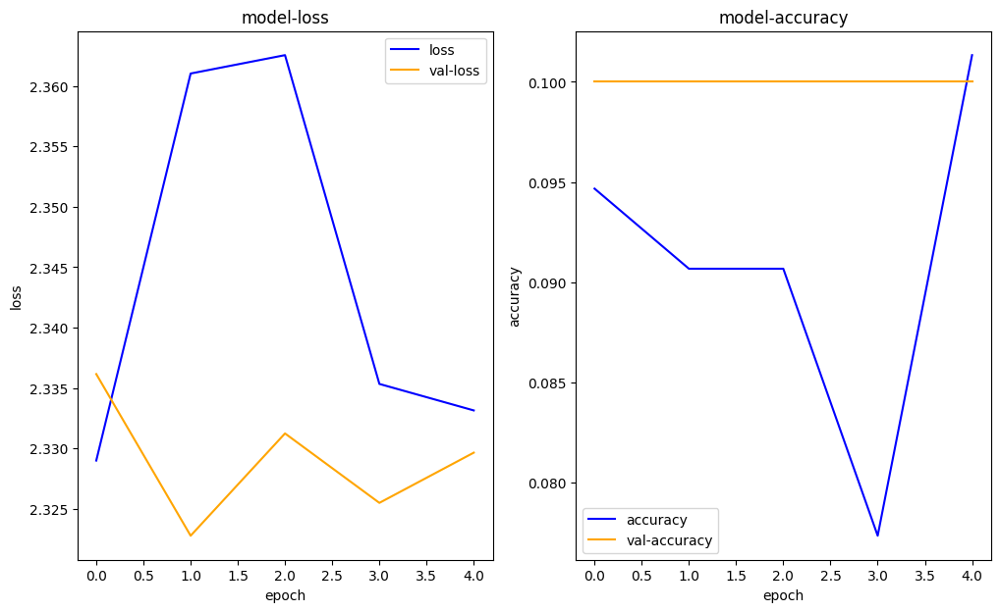

In [ ]:
plot_history(history_e1)

## Creating own Dataset Class

Ref: [Load and Preprocess data](https://www.tensorflow.org/tutorials/load_data/images)

What we can do with this class:
- We can get class_labels
- We can get train_ds and test_ds
- We can plot the prepared dataset


In [8]:
import os
import pathlib
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import gc

AUTOTUNE = tf.data.AUTOTUNE

class PrepareDataset:
    """
    Class to prepare the dataset for training and testing

    Args:
        train_dir: path to the directory containing the training dataset
        test_dir: path to the directory containing the testing dataset

    Functions:
        get_class_names: returns the list of class names
        get_label: returns the label of the image
        decode_img: decodes the image
        process_path: returns the image and label
        configure_for_performance: configures the dataset for performance
        get_dataset: returns the train_ds and test_ds
        plot_image_from_ds: plots the images from the dataset

    Returns:
        train_ds: training dataset
        test_ds: testing dataset
    """

    def __init__(self, train_dir, test_dir):
        """
        Args:
            train_dir: path to the directory containing the training dataset
            test_dir: path to the directory containing the testing dataset
        """
        self.train_dir = pathlib.Path(train_dir)
        self.test_dir = pathlib.Path(test_dir)
        self.class_names = self.get_class_names()  # Initialize class names

    def get_class_names(self):
        """
        Returns:
            class_names: list of class names
        """
        return np.array(sorted([item.name for item in self.train_dir.glob('*') if item.name != "LICENSE.txt"]))

    def get_label(self, file_path):
        """
        Returns the label of the image
        Args:
            file_path: path to the image
        Returns:
            label: label of the image
        """
        parts = tf.strings.split(file_path, os.path.sep)
        one_hot = parts[-2] == self.class_names
        return tf.cast(one_hot, tf.int32)

    def decode_img(self, img):
        """
        Decodes the image
        Args:
            img: image to be decoded
        Returns:
            img: decoded image
        """
        img = tf.io.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, [224, 224])
        return img

    def process_path(self, file_path):
        """
        Returns the image and label
        Args:
            file_path: path to the image
        Returns:
            img: image
            label: label of the image
        """
        label = self.get_label(file_path)
        img = tf.io.read_file(file_path)
        img = self.decode_img(img)
        img = tf.keras.layers.Resizing(224, 224)(img)
        return img, label

    def configure_for_performance(self, ds):
        """
        Configures the dataset for performance
        Args:
            ds: dataset to be configured
        Returns:
            ds: configured dataset
        """
        # ds = ds.cache()
        ds = ds.shuffle(buffer_size=1000)
        ds = ds.batch(32)
        ds = ds.prefetch(buffer_size=AUTOTUNE)
        return ds

    def get_dataset(self):
        """
        Returns:
            train_ds: training dataset
            test_ds: testing dataset
        """
        train_ds = tf.data.Dataset.list_files(str(self.train_dir/'*/*'), shuffle=False)
        test_ds = tf.data.Dataset.list_files(str(self.test_dir/'*/*'), shuffle=False)

        train_ds = train_ds.map(self.process_path, num_parallel_calls=AUTOTUNE)
        test_ds = test_ds.map(self.process_path, num_parallel_calls=AUTOTUNE)

        train_ds = self.configure_for_performance(train_ds)
        test_ds = self.configure_for_performance(test_ds)

        return train_ds, test_ds

    def plot_image_from_ds(self, ds):
        """
        Plots the images from the dataset
        Args:
            ds: dataset to plot
        Returns:
            None
        """
        image_batch, label_batch = next(iter(ds))

        plt.figure(figsize=(10, 10))
        for i in range(min(9, len(image_batch))):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(image_batch[i].numpy().astype("uint8"))
            label = np.argmax(label_batch[i].numpy())
            plt.title(self.class_names[label])
            plt.axis("off")
        plt.show()
        plt.clf()
        plt.close('all')
        gc.collect()

In [9]:
train_dir = '10_food_classes_10_percent/train/'
test_dir = '10_food_classes_10_percent/test/'
ds = PrepareDataset(train_dir, test_dir)
train_ds, test_ds = ds.get_dataset()

In [10]:
class_names = ds.class_names

In [ ]:
class_names

array(['chicken_curry', 'chicken_wings', 'fried_rice', 'grilled_salmon',
       'hamburger', 'ice_cream', 'pizza', 'ramen', 'steak', 'sushi'],
      dtype='<U14')

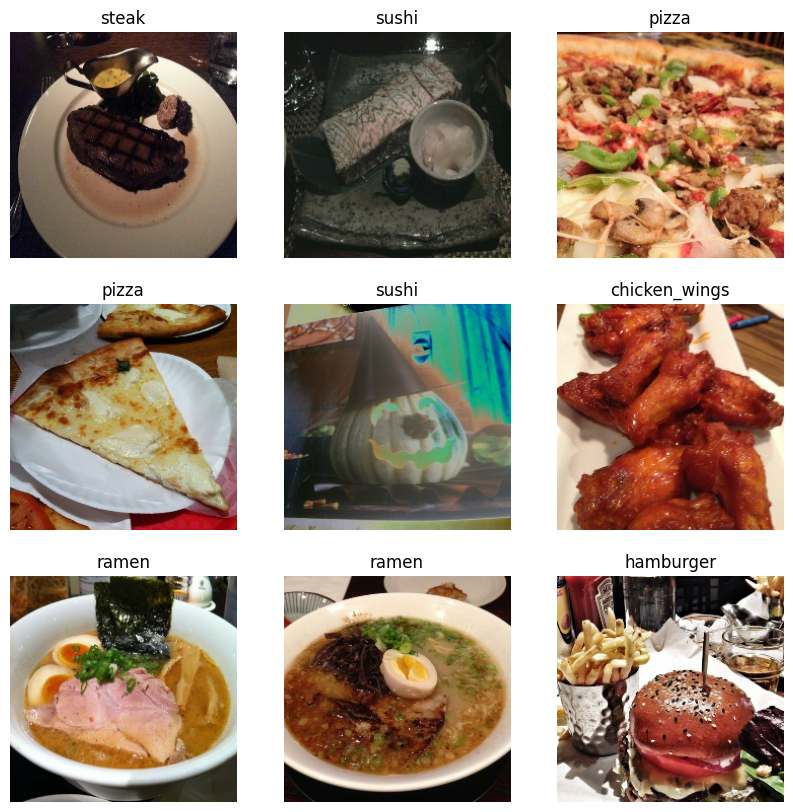

In [ ]:
ds.plot_image_from_ds(train_ds)

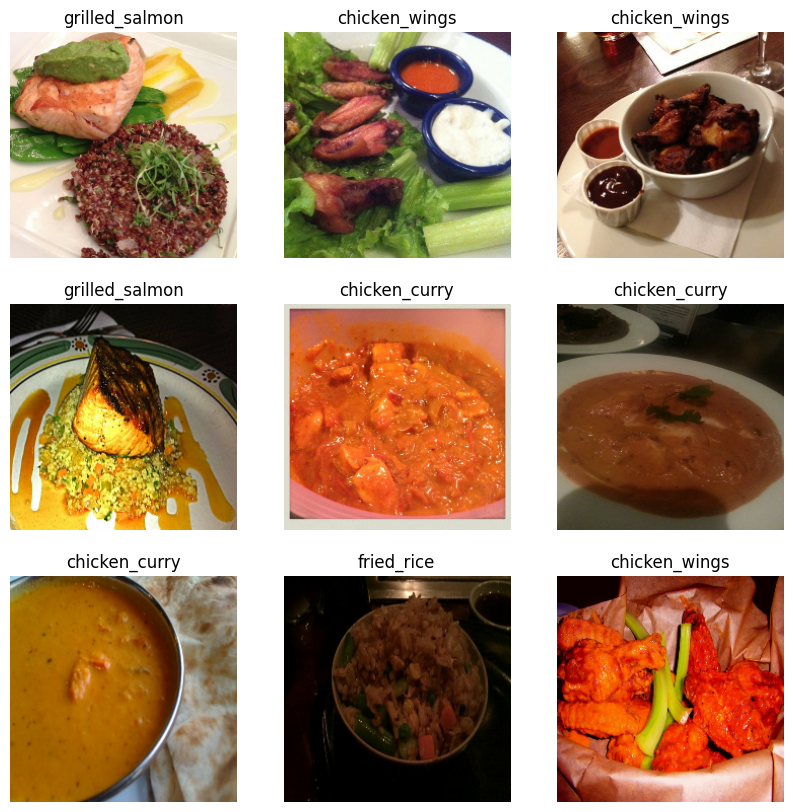

In [ ]:
ds.plot_image_from_ds(test_ds)

In [ ]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32, 10)


> `Note`: [EfficientNet Paper](https://arxiv.org/pdf/1905.11946)

In [ ]:
train_ds

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.int32, name=None))>

In [11]:
del ds

## Model 0: Building a transfer learning model using Keras Functional API

In [12]:
base_model = tf.keras.applications.EfficientNetB0(include_top = False)

base_model.trainable = False

inputs = tf.keras.layers.Input(shape = (224, 224, 3), name = 'input_layer')

x = base_model(inputs, training = False)
print(f"Shape after passing inputs through base model: {x.shape}")

x = tf.keras.layers.GlobalAveragePooling2D(name = 'global_average_pooling_layer')(x)
print(f"Shape after GlobalAveragePooling2D: {x.shape}")

outputs = tf.keras.layers.Dense(10, activation = 'softmax', name = 'output_layer')(x)
print(f"Shape after output layer: {outputs.shape}")

model_0 = tf.keras.Model(inputs, outputs)

model_0.compile(
    loss = 'categorical_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

model_0.summary()

Shape after passing inputs through base model: (None, 7, 7, 1280)
Shape after GlobalAveragePooling2D: (None, 1280)
Shape after output layer: (None, 10)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ efficientnetb0 (Functional)          │ (None, 7, 7, 1280)          │       4,049,571 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling_layer         │ (None, 1280)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ output_layer (Dense)                 │ (None, 10)                  │          12,810 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,062,381 (15.50 MB)

 Trainable params: 12,810 (50.04 KB)

 Non-trainable params: 4,049,571 (15.45 MB)

In [13]:
history_0 = model_0.fit(train_ds,
                        epochs = 5,
                        validation_data = test_ds,
                        callbacks = [create_tb_callback('tb_callback', 'exp_0')])

Saving tensorboard log files to: tb_callback/exp_0/20240823-130512
Epoch 1/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 64s 2s/step - accuracy: 0.2306 - loss: 2.1315 - val_accuracy: 0.6856 - val_loss: 1.3849
Epoch 2/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 9s 337ms/step - accuracy: 0.7153 - loss: 1.2663 - val_accuracy: 0.7732 - val_loss: 0.9718
Epoch 3/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 9s 336ms/step - accuracy: 0.7796 - loss: 0.9111 - val_accuracy: 0.8096 - val_loss: 0.7937
Epoch 4/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 8s 306ms/step - accuracy: 0.8210 - loss: 0.7932 - val_accuracy: 0.8192 - val_loss: 0.7030
Epoch 5/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 17s 518ms/step - accuracy: 0.8718 - loss: 0.6029 - val_accuracy: 0.8280 - val_loss: 0.6441


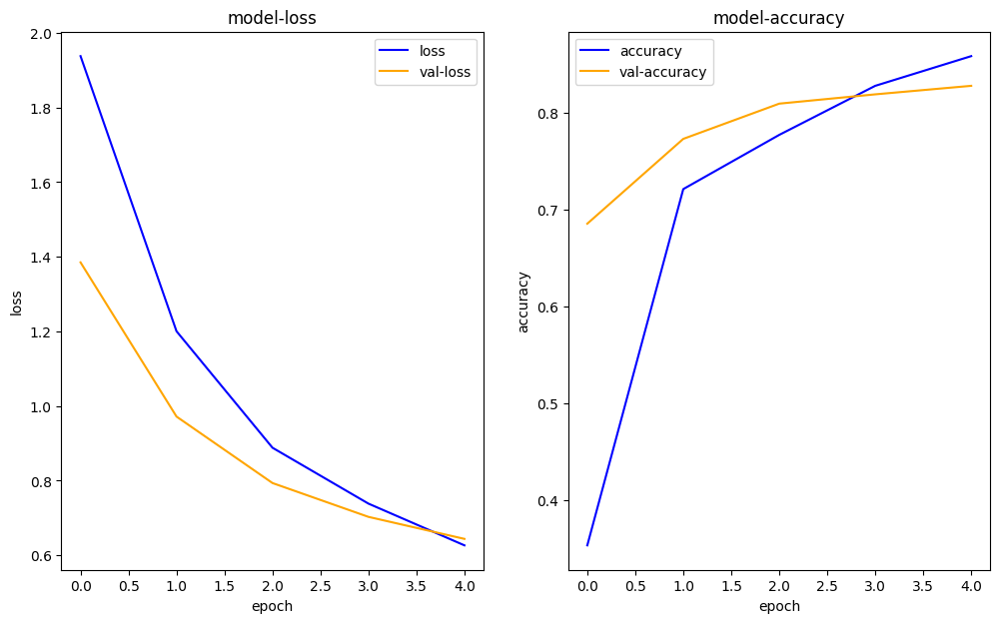

In [14]:
plot_history(history_0)

## Global Average/Max Pooling 2D Working
Averages the column form each 2D slices of the 3D tensor

(0.3274685 -1.4075519 -0.5573232 + 0.28893656)/4 = -0.33711751 : first column output

Similarly, Max pool outputs max from each 2D slices of the 3D tensor


max(0.3274685, -1.4075519, -0.5573232, 0.28893656) = 0.3274685

In [ ]:
tf.random.set_seed(42)

input_shape = (1, 2, 2, 3)
input_tensor = tf.random.normal(input_shape)
print(f"Random input tensor: \n {input_tensor} \n")

gap_tensor = tf.keras.layers.GlobalAveragePooling2D()(input_tensor)
print(f"Global Average Pooled Input Tensor: \n {gap_tensor} \n")

print(f"Input Tensor shape: {input_shape}\n GAP Tensor shape: {gap_tensor.shape}")

Random input tensor: 
 [[[[ 0.3274685  -0.8426258   0.3194337 ]
   [-1.4075519  -2.3880599  -1.0392479 ]]

  [[-0.5573232   0.539707    1.6994323 ]
   [ 0.28893656 -1.5066116  -0.2645474 ]]]] 

Global Average Pooled Input Tensor: 
 [[-0.3371175  -1.0493976   0.17876767]] 

Input Tensor shape: (1, 2, 2, 3)
 GAP Tensor shape: (1, 3)


In [ ]:
tf.random.set_seed(42)

input_shape = (1, 2, 2, 3)
input_tensor = tf.random.normal(input_shape)
print(f"Random input tensor: \n {input_tensor} \n")

gmp_tensor = tf.keras.layers.GlobalMaxPooling2D()(input_tensor)
print(f"Global Max Pooled Input Tensor: \n {gmp_tensor} \n")

print(f"Input Tensor shape: {input_shape}\n GMP Tensor shape: {gmp_tensor.shape}")

Random input tensor: 
 [[[[ 0.3274685  -0.8426258   0.3194337 ]
   [-1.4075519  -2.3880599  -1.0392479 ]]

  [[-0.5573232   0.539707    1.6994323 ]
   [ 0.28893656 -1.5066116  -0.2645474 ]]]] 

Global Max Pooled Input Tensor: 
 [[0.3274685 0.539707  1.6994323]] 

Input Tensor shape: (1, 2, 2, 3)
 GMP Tensor shape: (1, 3)


## Model Experiments

1. `model_1` - use feature extraction transfer learning with 1% of training data
with data augmentation
2. `model_2` - use feature extraction transfer learning with 10% of training data with data augmentation
3. `model_3` - use fine tuning transfer learning with 10% of training data
with data augmentation
4. `model_4` - use fine tuning transfer learning with 100% of training data
with data augmentation

**Note**: Throughout the model experimentation we'll use the same dataset for model training and evaluation.

In [15]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_1_percent.zip
zip_ref = zipfile.ZipFile("/content/10_food_classes_1_percent.zip")
zip_ref.extractall()
zip_ref.close()

--2024-08-23 13:07:01--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_1_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.142.207, 74.125.195.207, 172.253.117.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.142.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 133612354 (127M) [application/zip]
Saving to: ‘10_food_classes_1_percent.zip.1’

10_food_classes_1_p 100%[===================>] 127.42M   220MB/s    in 0.6s    

2024-08-23 13:07:02 (220 MB/s) - ‘10_food_classes_1_percent.zip.1’ saved [133612354/133612354]



In [18]:
walk_through_dir("10_food_classes_1_percent")

There are 2 directories and 0 images in 10_food_classes_1_percent
There are 10 directories and 0 images in 10_food_classes_1_percent/test
There are 0 directories and 250 images in 10_food_classes_1_percent/test/ice_cream
There are 0 directories and 250 images in 10_food_classes_1_percent/test/chicken_curry
There are 0 directories and 250 images in 10_food_classes_1_percent/test/sushi
There are 0 directories and 250 images in 10_food_classes_1_percent/test/steak
There are 0 directories and 250 images in 10_food_classes_1_percent/test/fried_rice
There are 0 directories and 250 images in 10_food_classes_1_percent/test/ramen
There are 0 directories and 250 images in 10_food_classes_1_percent/test/pizza
There are 0 directories and 250 images in 10_food_classes_1_percent/test/grilled_salmon
There are 0 directories and 250 images in 10_food_classes_1_percent/test/hamburger
There are 0 directories and 250 images in 10_food_classes_1_percent/test/chicken_wings
There are 10 directories and 0 ima

In [16]:
train_dir_1 = '10_food_classes_1_percent/train/'
test_dir_1 = '10_food_classes_1_percent/test/'

ds_1 = PrepareDataset(train_dir_1, test_dir_1)
class_names_1 = ds_1.class_names
train_ds_1, test_ds_1 = ds_1.get_dataset()

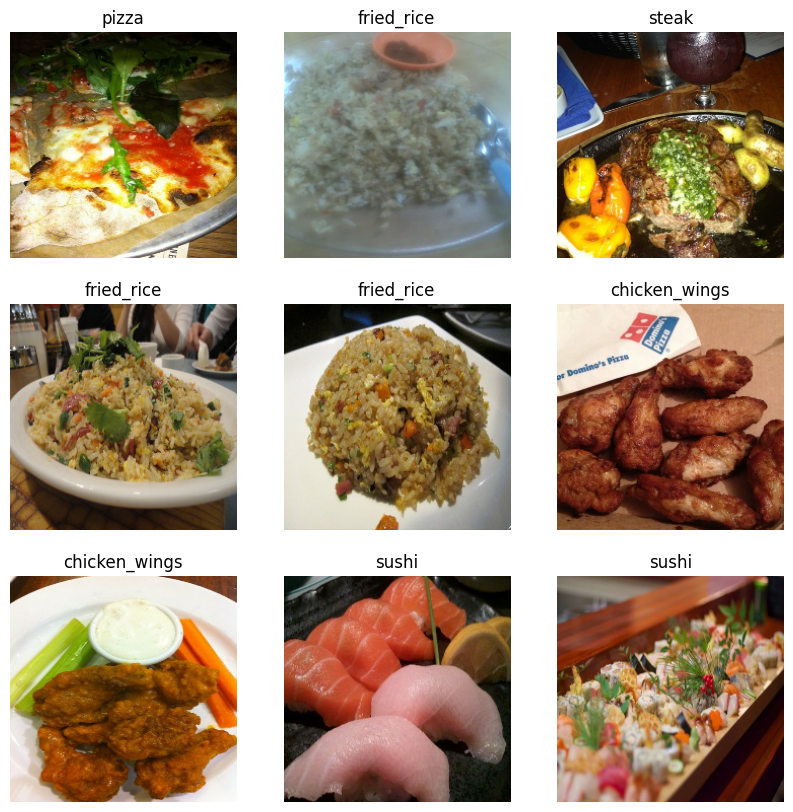

In [16]:
ds_1.plot_image_from_ds(train_ds_1)

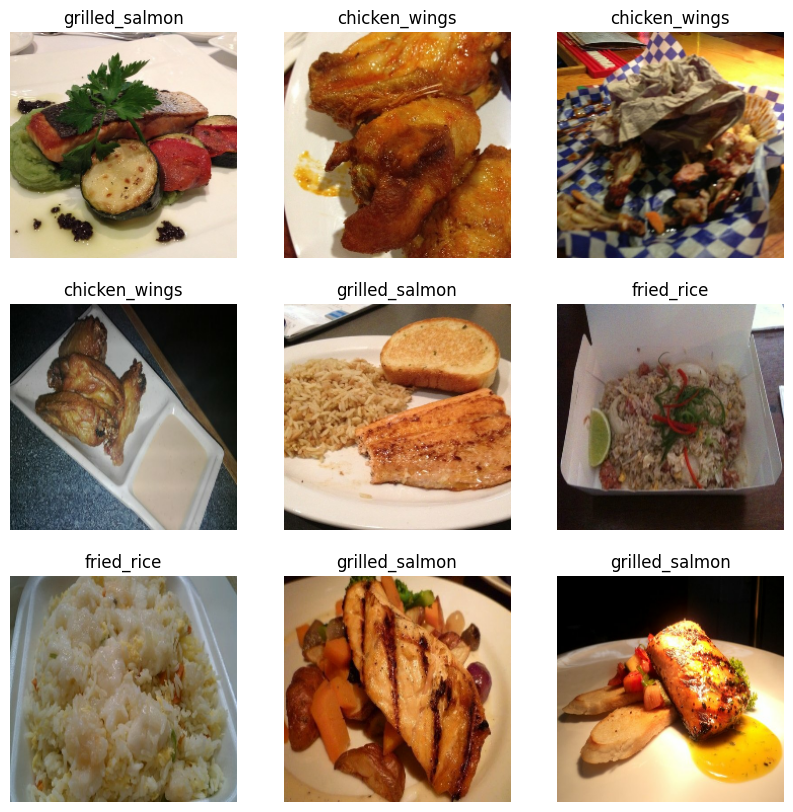

In [ ]:
ds_1.plot_image_from_ds(test_ds_1)

In [17]:
del ds_1

## Data Augmentation

In [18]:
from tensorflow.keras import layers
def data_augmentation():
    augmentation_model = tf.keras.Sequential([
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.2),
        layers.RandomZoom(0.2),
        layers.RandomHeight(0.2),
        layers.RandomWidth(0.2),
        # layers.Rescaling(1./255),
    ], name = 'data_augmentaion')
    return augmentation_model

**Note**: Adding Rescaling() layer is mistake, this is not required for efficentnet base model as they already have this. This will lead to extra resource consumption and training may be ineffective due to small yet very significant mistakes when it comes to model training. However other models may requrire this like ResNet.

## Visualize Random Image

In [19]:
import random

def random_augmented_image(data_dir, class_names):
    """
    Returns random augmented image along with
    original image.
    """

    target_class = random.choice(class_names)
    train_or_test = random.choice(['train', 'test'])
    target_dir = data_dir +  '/' + train_or_test + '/' + target_class
    random_img = random.choice(os.listdir(target_dir))
    random_img_path = target_dir + "/" + random_img
    img = plt.imread(random_img_path)
    aug_img = data_augmentation()(tf.expand_dims(img/255., axis = 0))

    fig, ax = plt.subplots(1, 2, figsize = (10, 7))
    ax[0].imshow(np.squeeze(img))
    ax[0].set_title(f"Original {target_class}: {img.shape}")
    ax[0].axis('off')
    ax[1].imshow(aug_img[0])
    ax[1].set_title(f"Augmented {target_class}: {aug_img.shape}")
    ax[1].axis('off')

    plt.show()
    plt.clf()
    plt.close()

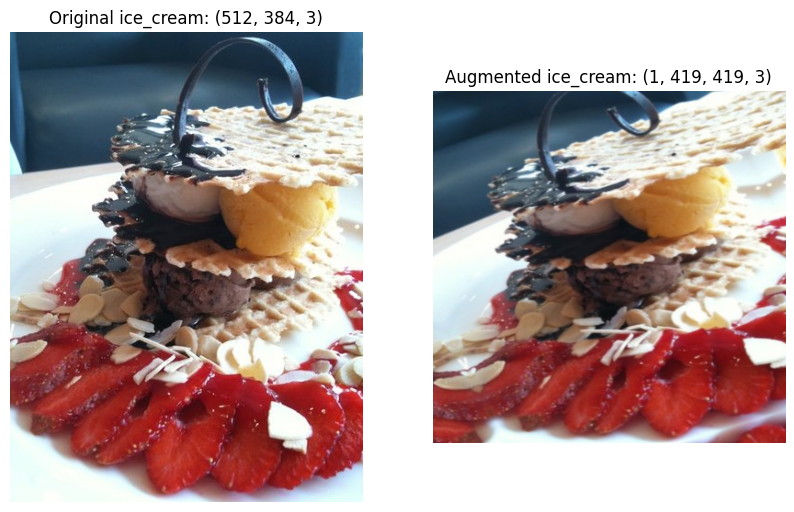

In [ ]:
random_augmented_image("10_food_classes_1_percent", class_names_1)

## Model_1 Experiment

In [20]:
def create_base_model(input_shape = (224, 224, 3),
                      output_shape = 10,
                      learning_rate = 0.001,
                      training = False,
                      base_model = tf.keras.applications.EfficientNetB0):
    """
    Create a model based on EfficientNetV2B0 with built-in data augmentation.

    Parameters:
    - input_shape (tuple): Expected shape of input images. Default is (224, 224, 3).
    - output_shape (int): Number of classes for the output layer. Default is 10.
    - learning_rate (float): Learning rate for the Adam optimizer. Default is 0.001.
    - training (bool): Whether the base model is trainable. Default is False.

    Returns:
    - tf.keras.Model: The compiled model with specified input and output settings.
    """

    # Create base model
    base_model = base_model(include_top = False)
    base_model.trainable = training

    # Setup model input and outputs with data augmentation built-in
    inputs = layers.Input(shape=input_shape, name="input_layer")
    x = data_augmentation()(inputs)
    x = base_model(x, training=False)  # pass augmented images to base model but keep it in inference mode
    x = layers.GlobalAveragePooling2D(name="global_average_pooling_layer")(x)
    outputs = layers.Dense(units=output_shape, activation="softmax", name="output_layer")(x)
    model = tf.keras.Model(inputs, outputs)

    # Compile model
    model.compile(loss="categorical_crossentropy",
                  optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                  metrics=["accuracy"])

    return model

In [21]:
model_1 = create_base_model()

In [22]:
history_1 = model_1.fit(train_ds_1,
                        epochs = 5,
                        validation_data = test_ds_1,
                        validation_steps = int(0.25 * len(test_ds_1)),
                        callbacks = [create_tb_callback('tb_callback', 'exp_1')])

Saving tensorboard log files to: tb_callback/exp_1/20240823-130706
Epoch 1/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 24s 5s/step - accuracy: 0.1008 - loss: 2.3765 - val_accuracy: 0.1003 - val_loss: 2.3764
Epoch 2/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 734ms/step - accuracy: 0.1781 - loss: 2.2077 - val_accuracy: 0.2319 - val_loss: 2.1515
Epoch 3/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 760ms/step - accuracy: 0.3401 - loss: 2.0166 - val_accuracy: 0.3092 - val_loss: 2.0474
Epoch 4/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 733ms/step - accuracy: 0.4545 - loss: 1.8787 - val_accuracy: 0.3273 - val_loss: 1.9931
Epoch 5/5
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 758ms/step - accuracy: 0.5787 - loss: 1.7019 - val_accuracy: 0.3382 - val_loss: 1.8760


/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


In [23]:
results_1 = model_1.evaluate(test_ds_1)
results_1

79/79 ━━━━━━━━━━━━━━━━━━━━ 7s 73ms/step - accuracy: 0.3586 - loss: 1.9466


[1.9233062267303467, 0.37439998984336853]

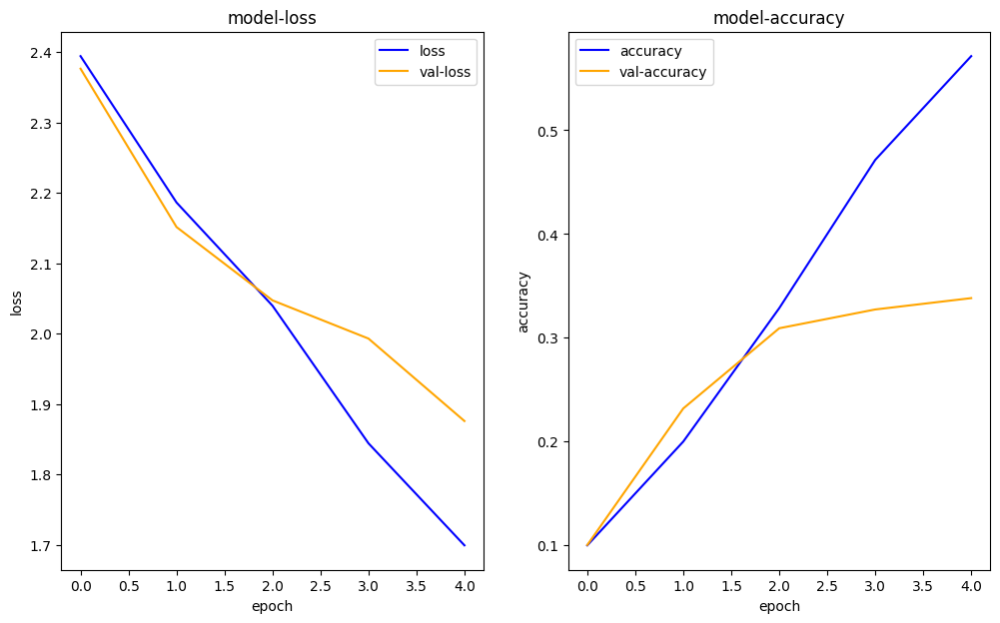

In [24]:
plot_history(history_1)

## Model_2 Experiment

In [25]:
ds_10 = PrepareDataset(train_dir, test_dir)
class_names_10 = ds_10.class_names
train_ds_10, test_ds_10 = ds_10.get_dataset()

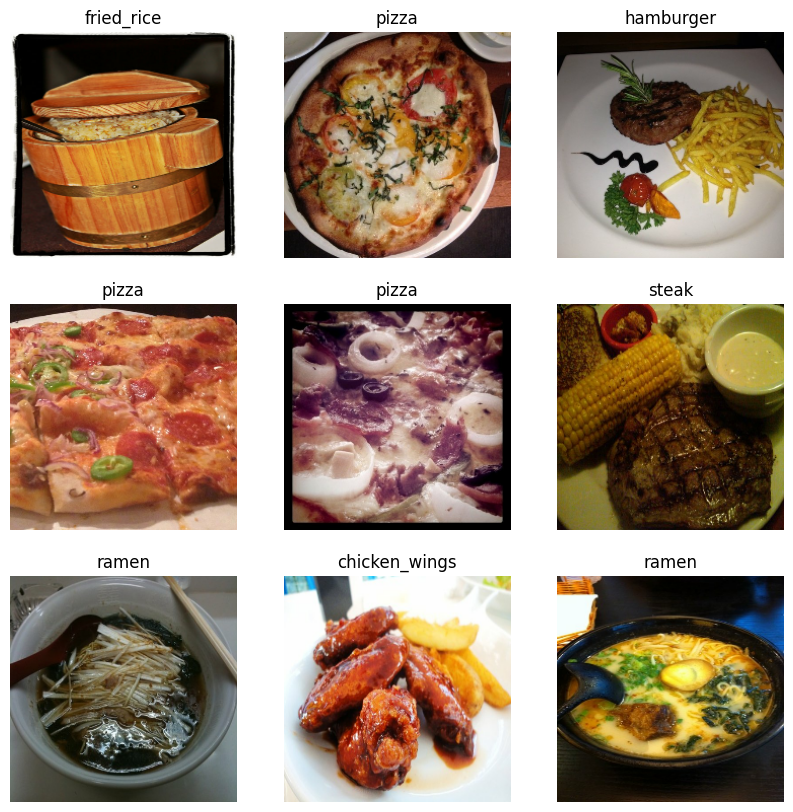

In [28]:
ds_10.plot_image_from_ds(train_ds_10)

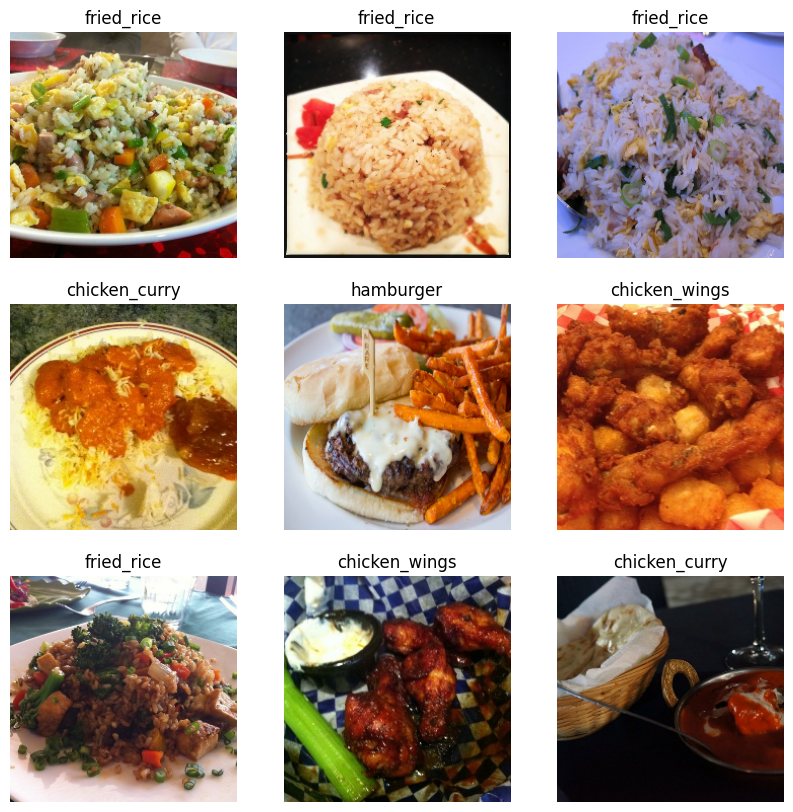

In [ ]:
ds_10.plot_image_from_ds(test_ds_10)

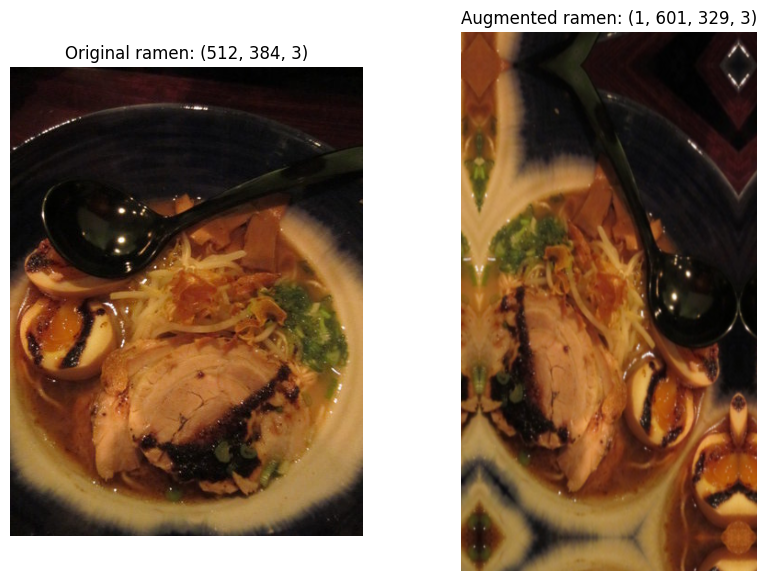

In [29]:
random_augmented_image('10_food_classes_10_percent', class_names_10)

In [26]:
del ds_10

## Creating Model Checkpoint

This technique can be used to save entire model or model weights during training.

In [27]:
def cp_callback(dir_name = "model_checkpoint", experiment_name=None):
    # Create a timestamped directory for saving model checkpoints
    checkpoint_dir = dir_name + '/' + experiment_name + '/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

    # Create a callback for saving the model checkpoints
    checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_dir + '/epoch_{epoch:02d}_{val_loss:.2f}.weights.h5',
        save_weights_only=True,
        save_best_only=True,
        monitor='val_loss',
        save_freq = 'epoch',
        verbose=1
    )

    print(f"Saving model checkpoints to: {checkpoint_dir}")
    return checkpoint_callback

In [28]:
import gc
gc.collect()

8012

In [29]:
model_2 = create_base_model(base_model = tf.keras.applications.EfficientNetB3)
history_2 = model_2.fit(train_ds_10,
                        epochs = 5,
                        validation_data = test_ds_10,
                        validation_steps = int(0.25 * len(test_ds_10)),
                        callbacks = [create_tb_callback('tb_callback', 'exp_2'),
                                     cp_callback('model_checkpoint', 'model_2')])

Saving tensorboard log files to: tb_callback/exp_2/20240823-130751
Saving model checkpoints to: model_checkpoint/model_2/20240823-130751
Epoch 1/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - accuracy: 0.2260 - loss: 2.1878
Epoch 1: val_loss improved from inf to 1.58271, saving model to model_checkpoint/model_2/20240823-130751/epoch_01_1.58.weights.h5
24/24 ━━━━━━━━━━━━━━━━━━━━ 35s 783ms/step - accuracy: 0.2300 - loss: 2.1810 - val_accuracy: 0.5658 - val_loss: 1.5827
Epoch 2/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step - accuracy: 0.6151 - loss: 1.4808
Epoch 2: val_loss improved from 1.58271 to 0.91021, saving model to model_checkpoint/model_2/20240823-130751/epoch_02_0.91.weights.h5
24/24 ━━━━━━━━━━━━━━━━━━━━ 11s 338ms/step - accuracy: 0.6161 - loss: 1.4764 - val_accuracy: 0.8125 - val_loss: 0.9102
Epoch 3/5
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step - accuracy: 0.7084 - loss: 1.1022
Epoch 3: val_loss improved from 0.91021 to 0.80933, saving model to model_checkpoint/model_2/20240823-130751

In [30]:
results_2 = model_2.evaluate(test_ds_10)
results_2

79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 136ms/step - accuracy: 0.7903 - loss: 0.7236


[0.6975607872009277, 0.7964000105857849]

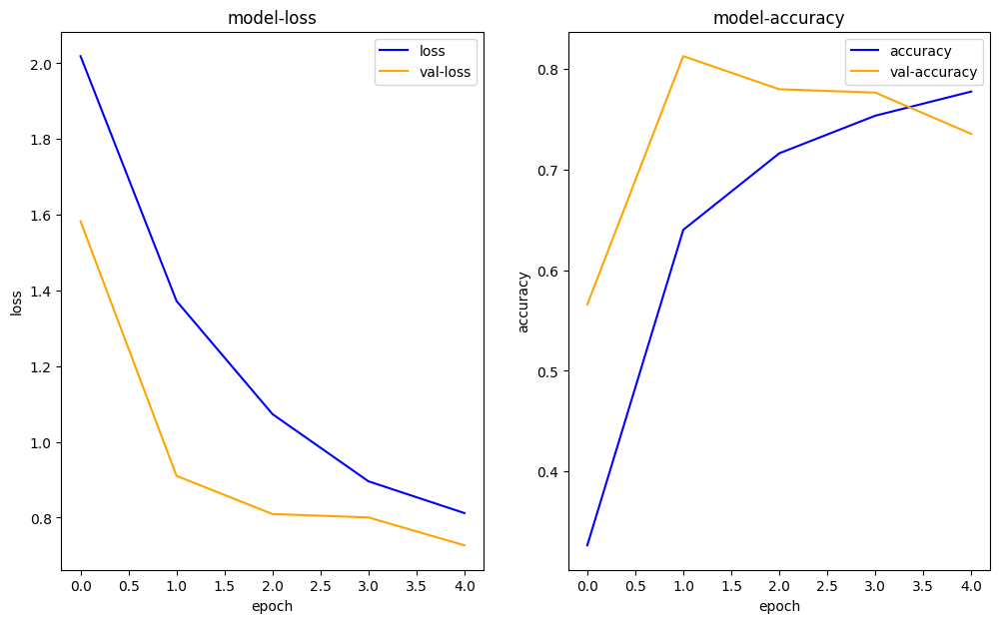

In [31]:
plot_history(history_2)

In [ ]:
model_1.save_weights('models/model_1.weights.h5')
model_2.save_weights('models/model_2.weights.h5')

In [ ]:
load_model = create_base_model()
load_model.load_weights('models/model_1.weights.h5')
load_model.evaluate(test_ds_1)

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 6 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


79/79 ━━━━━━━━━━━━━━━━━━━━ 10s 73ms/step - accuracy: 0.3976 - loss: 1.8712


[1.8987394571304321, 0.36559998989105225]

## Model 3: Fine Tuning on 10% Data with transfer learning

We'll unfreeze some portion of base model layers to train them.

> `Note`: Fine tuning works best after doing feature extraction on large custom dataset for few epochs.

In [32]:
model_2.layers

[<InputLayer name=input_layer, built=True>,
 <Sequential name=data_augmentaion, built=True>,
 <Functional name=efficientnetb3, built=True>,
 <GlobalAveragePooling2D name=global_average_pooling_layer, built=True>,
 <Dense name=output_layer, built=True>]

In [33]:
for layer in model_2.layers:
    print(layer, layer.trainable)

<InputLayer name=input_layer, built=True> True
<Sequential name=data_augmentaion, built=True> True
<Functional name=efficientnetb3, built=True> False
<GlobalAveragePooling2D name=global_average_pooling_layer, built=True> True
<Dense name=output_layer, built=True> True


In [34]:
for layer in model_2.layers[2].layers:
    print(layer, layer.trainable)

<InputLayer name=input_layer_3, built=True> False
<Rescaling name=rescaling_4, built=True> False
<Normalization name=normalization_2, built=True> False
<Rescaling name=rescaling_5, built=True> False
<ZeroPadding2D name=stem_conv_pad, built=True> False
<Conv2D name=stem_conv, built=True> False
<BatchNormalization name=stem_bn, built=True> False
<Activation name=stem_activation, built=True> False
<DepthwiseConv2D name=block1a_dwconv, built=True> False
<BatchNormalization name=block1a_bn, built=True> False
<Activation name=block1a_activation, built=True> False
<GlobalAveragePooling2D name=block1a_se_squeeze, built=True> False
<Reshape name=block1a_se_reshape, built=True> False
<Conv2D name=block1a_se_reduce, built=True> False
<Conv2D name=block1a_se_expand, built=True> False
<Multiply name=block1a_se_excite, built=True> False
<Conv2D name=block1a_project_conv, built=True> False
<BatchNormalization name=block1a_project_bn, built=True> False
<DepthwiseConv2D name=block1b_dwconv, built=True>

In [35]:
print(len(model_2.layers[2].trainable_variables))

0


In [36]:
model_2.layers[2].trainable = True

# freeze all layers except last 10 layers
for layer in model_2.layers[2].layers[:-10]:
    layer.trainable = False

# lower the lr by 10x when fine tuning
model_2.compile(loss = 'categorical_crossentropy',
                optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0001),
                metrics = ['accuracy'])

> Read [ULMFit paper](https://arxiv.org/pdf/1801.06146)

In [37]:
for layer in model_2.layers[2].layers:
    print(layer, layer.trainable)

<InputLayer name=input_layer_3, built=True> False
<Rescaling name=rescaling_4, built=True> False
<Normalization name=normalization_2, built=True> False
<Rescaling name=rescaling_5, built=True> False
<ZeroPadding2D name=stem_conv_pad, built=True> False
<Conv2D name=stem_conv, built=True> False
<BatchNormalization name=stem_bn, built=True> False
<Activation name=stem_activation, built=True> False
<DepthwiseConv2D name=block1a_dwconv, built=True> False
<BatchNormalization name=block1a_bn, built=True> False
<Activation name=block1a_activation, built=True> False
<GlobalAveragePooling2D name=block1a_se_squeeze, built=True> False
<Reshape name=block1a_se_reshape, built=True> False
<Conv2D name=block1a_se_reduce, built=True> False
<Conv2D name=block1a_se_expand, built=True> False
<Multiply name=block1a_se_excite, built=True> False
<Conv2D name=block1a_project_conv, built=True> False
<BatchNormalization name=block1a_project_bn, built=True> False
<DepthwiseConv2D name=block1b_dwconv, built=True>

In [38]:
# Fine tune for another 5 epochs
initial_epochs = history_2.epoch[-1]
extra_epochs = 5
history_3 = model_2.fit(train_ds_10,
                        epochs = initial_epochs + extra_epochs,
                        validation_data = test_ds_10,
                        validation_steps = int(0.25 * len(test_ds_10)),
                        callbacks = [create_tb_callback('tb_callback', 'exp_3'),
                                     cp_callback('model_checkpoint', 'model_3')],
                        initial_epoch = history_2.epoch[-1])

Saving tensorboard log files to: tb_callback/exp_3/20240823-131000
Saving model checkpoints to: model_checkpoint/model_3/20240823-131000
Epoch 5/9
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step - accuracy: 0.7414 - loss: 0.8625
Epoch 5: val_loss improved from inf to 0.72632, saving model to model_checkpoint/model_3/20240823-131000/epoch_05_0.73.weights.h5
24/24 ━━━━━━━━━━━━━━━━━━━━ 34s 578ms/step - accuracy: 0.7417 - loss: 0.8607 - val_accuracy: 0.7796 - val_loss: 0.7263
Epoch 6/9
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step - accuracy: 0.7962 - loss: 0.7008
Epoch 6: val_loss improved from 0.72632 to 0.51202, saving model to model_checkpoint/model_3/20240823-131000/epoch_06_0.51.weights.h5
24/24 ━━━━━━━━━━━━━━━━━━━━ 13s 316ms/step - accuracy: 0.7968 - loss: 0.6995 - val_accuracy: 0.8355 - val_loss: 0.5120
Epoch 7/9
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step - accuracy: 0.8596 - loss: 0.5816
Epoch 7: val_loss did not improve from 0.51202
24/24 ━━━━━━━━━━━━━━━━━━━━ 8s 289ms/step - accuracy: 0.8590 -

In [39]:
results_3 = model_2.evaluate(test_ds_10)
results_3

79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 137ms/step - accuracy: 0.8261 - loss: 0.5623


[0.5792776942253113, 0.8144000172615051]

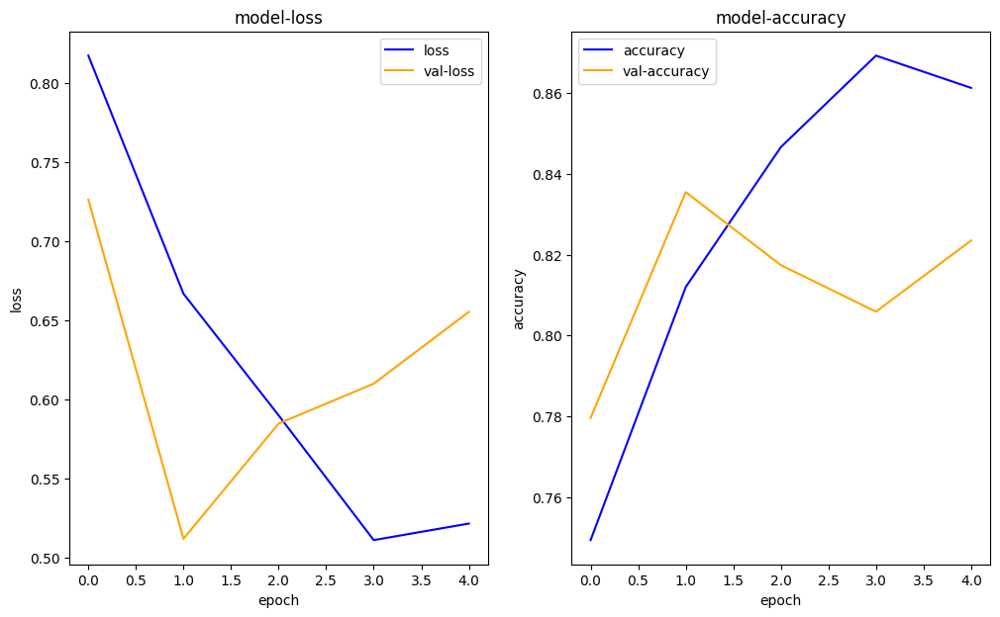

In [40]:
plot_history(history_3)

In [41]:
def compare_history(original_history, new_history, initial_epochs=5):
    """
    Compares two model history objects.
    """
    # Get original history measurements
    acc = original_history.history["accuracy"]
    loss = original_history.history["loss"]

    print(len(acc))

    val_acc = original_history.history["val_accuracy"]
    val_loss = original_history.history["val_loss"]

    # Combine original history with new history
    total_acc = acc + new_history.history["accuracy"]
    total_loss = loss + new_history.history["loss"]

    total_val_acc = val_acc + new_history.history["val_accuracy"]
    total_val_loss = val_loss + new_history.history["val_loss"]

    print(len(total_acc))
    print(total_acc)

    # Make plots
    plt.figure(figsize=(8, 8))
    plt.subplot(2, 1, 1)
    plt.plot(total_acc, label='Training Accuracy')
    plt.plot(total_val_acc, label='Validation Accuracy')
    plt.plot([initial_epochs-1, initial_epochs-1],
              plt.ylim(), label='Start Fine Tuning') # reshift plot around epochs
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')

    plt.subplot(2, 1, 2)
    plt.plot(total_loss, label='Training Loss')
    plt.plot(total_val_loss, label='Validation Loss')
    plt.plot([initial_epochs-1, initial_epochs-1],
              plt.ylim(), label='Start Fine Tuning') # reshift plot around epochs
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')
    plt.xlabel('epoch')
    plt.show();

5
10
[0.3266666531562805, 0.6399999856948853, 0.7160000205039978, 0.753333330154419, 0.7773333191871643, 0.7493333220481873, 0.8119999766349792, 0.846666693687439, 0.8693333268165588, 0.8613333106040955]


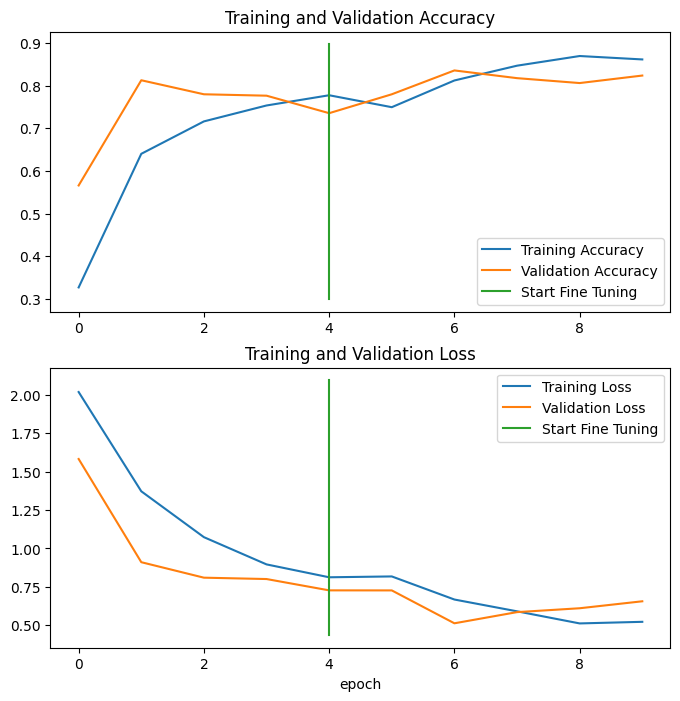

In [42]:
compare_history(history_2, history_3)

In [43]:
gc.collect()

15405

## Model 4: Feature Extraction + Fine Tuning with 100% dataset

In [44]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_all_data.zip

zip_ref = zipfile.ZipFile("/content/10_food_classes_all_data.zip")
zip_ref.extractall()
zip_ref.close()

--2024-08-23 13:11:33--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_all_data.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.20.207, 108.177.98.207, 74.125.197.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.20.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 519183241 (495M) [application/zip]
Saving to: ‘10_food_classes_all_data.zip.1’

10_food_classes_all 100%[===================>] 495.13M   235MB/s    in 2.1s    

2024-08-23 13:11:35 (235 MB/s) - ‘10_food_classes_all_data.zip.1’ saved [519183241/519183241]



In [45]:
ds_100 = PrepareDataset('10_food_classes_all_data/train/', '10_food_classes_all_data/test/')
class_names_100 = ds_100.class_names
train_ds_100, test_ds_100 = ds_100.get_dataset()

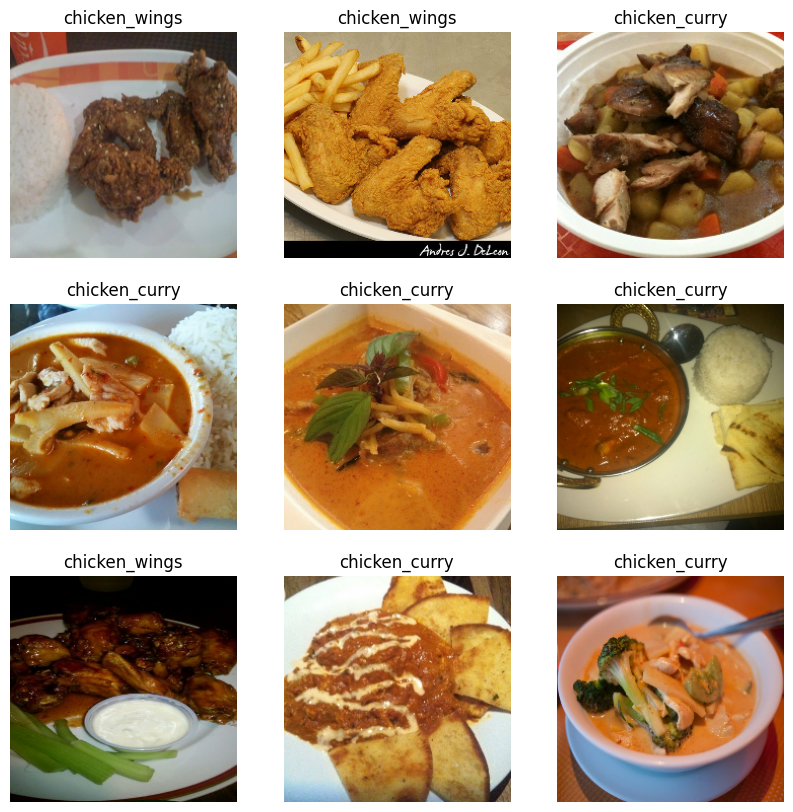

In [ ]:
ds_100.plot_image_from_ds(train_ds_100)

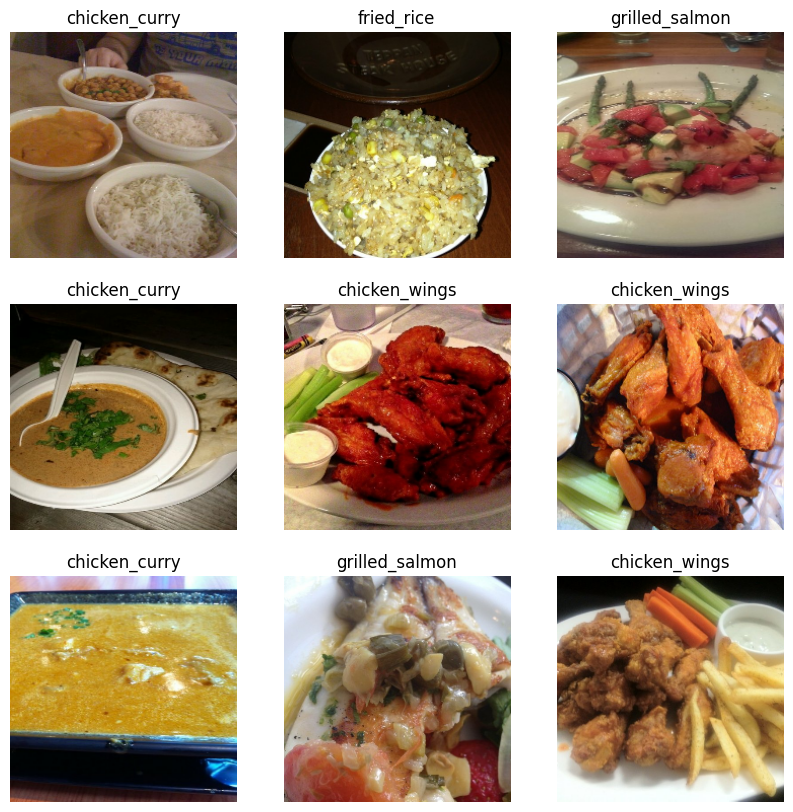

In [ ]:
ds_100.plot_image_from_ds(test_ds_100)

In [ ]:
walk_through_dir('10_food_classes_all_data')

There are 2 directories and 0 images in 10_food_classes_all_data
There are 10 directories and 0 images in 10_food_classes_all_data/test
There are 0 directories and 250 images in 10_food_classes_all_data/test/ice_cream
There are 0 directories and 250 images in 10_food_classes_all_data/test/chicken_curry
There are 0 directories and 250 images in 10_food_classes_all_data/test/sushi
There are 0 directories and 250 images in 10_food_classes_all_data/test/steak
There are 0 directories and 250 images in 10_food_classes_all_data/test/fried_rice
There are 0 directories and 250 images in 10_food_classes_all_data/test/ramen
There are 0 directories and 250 images in 10_food_classes_all_data/test/pizza
There are 0 directories and 250 images in 10_food_classes_all_data/test/grilled_salmon
There are 0 directories and 250 images in 10_food_classes_all_data/test/hamburger
There are 0 directories and 250 images in 10_food_classes_all_data/test/chicken_wings
There are 10 directories and 0 images in 10_fo

In [ ]:
train_ds_100

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 10), dtype=tf.int32, name=None))>

In [ ]:
for images, labels in train_ds_100.take(1):
    print(images.shape)
    print(labels.shape)
    break

(32, 224, 224, 3)
(32, 10)


In [42]:
len(class_names_100)

10

In [46]:
del ds_100

In [47]:
model_2.evaluate(test_ds_100)

79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 136ms/step - accuracy: 0.8084 - loss: 0.5911


[0.5792776346206665, 0.8144000172615051]

In [48]:
results_3

[0.5792776942253113, 0.8144000172615051]

In [49]:
gc.collect()

55

To train a fine-tune model_4 we need to revert model_2 back to its feature extraction weights.

In [51]:
model_2.load_weights("/content/model_checkpoint/model_2/20240823-130751/epoch_05_0.73.weights.h5")

In [52]:
model_2.evaluate(test_ds_100)

79/79 ━━━━━━━━━━━━━━━━━━━━ 12s 135ms/step - accuracy: 0.7701 - loss: 0.7453


[0.697560727596283, 0.7964000105857849]

In [53]:
for layer_number, layer in enumerate(model_2.layers):
    print(layer_number, layer.name, layer.trainable)

0 input_layer True
1 data_augmentaion True
2 efficientnetb3 True
3 global_average_pooling_layer True
4 output_layer True


In [54]:
for layer_number, layer in enumerate(model_2.layers[2].layers):
    print(layer_number, layer.name, layer.trainable)

0 input_layer_3 False
1 rescaling_4 False
2 normalization_2 False
3 rescaling_5 False
4 stem_conv_pad False
5 stem_conv False
6 stem_bn False
7 stem_activation False
8 block1a_dwconv False
9 block1a_bn False
10 block1a_activation False
11 block1a_se_squeeze False
12 block1a_se_reshape False
13 block1a_se_reduce False
14 block1a_se_expand False
15 block1a_se_excite False
16 block1a_project_conv False
17 block1a_project_bn False
18 block1b_dwconv False
19 block1b_bn False
20 block1b_activation False
21 block1b_se_squeeze False
22 block1b_se_reshape False
23 block1b_se_reduce False
24 block1b_se_expand False
25 block1b_se_excite False
26 block1b_project_conv False
27 block1b_project_bn False
28 block1b_drop False
29 block1b_add False
30 block2a_expand_conv False
31 block2a_expand_bn False
32 block2a_expand_activation False
33 block2a_dwconv_pad False
34 block2a_dwconv False
35 block2a_bn False
36 block2a_activation False
37 block2a_se_squeeze False
38 block2a_se_reshape False
39 block2a_s

In [55]:
model_2.compile(loss = 'categorical_crossentropy',
                optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001),
                metrics = ['accuracy'])

history_4 = model_2.fit(train_ds_100,
                        epochs = initial_epochs + 5,
                        validation_data = test_ds_100,
                        validation_steps = int(0.25 * len(test_ds_100)),
                        callbacks = [create_tb_callback('tb_callback', 'exp_4'),
                                     cp_callback('model_checkpoint', 'model_4')],
                        initial_epoch = history_2.epoch[-1])

Saving tensorboard log files to: tb_callback/exp_4/20240823-131343
Saving model checkpoints to: model_checkpoint/model_4/20240823-131343
Epoch 5/9
235/235 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - accuracy: 0.6340 - loss: 1.2258
Epoch 5: val_loss improved from inf to 1.47141, saving model to model_checkpoint/model_4/20240823-131343/epoch_05_1.47.weights.h5
235/235 ━━━━━━━━━━━━━━━━━━━━ 74s 234ms/step - accuracy: 0.6342 - loss: 1.2253 - val_accuracy: 0.5049 - val_loss: 1.4714
Epoch 6/9
235/235 ━━━━━━━━━━━━━━━━━━━━ 0s 199ms/step - accuracy: 0.5994 - loss: 1.2350
Epoch 6: val_loss improved from 1.47141 to 0.76600, saving model to model_checkpoint/model_4/20240823-131343/epoch_06_0.77.weights.h5
235/235 ━━━━━━━━━━━━━━━━━━━━ 77s 213ms/step - accuracy: 0.5998 - loss: 1.2338 - val_accuracy: 0.7122 - val_loss: 0.7660
Epoch 7/9
235/235 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - accuracy: 0.6595 - loss: 1.0361
Epoch 7: val_loss improved from 0.76600 to 0.53618, saving model to model_checkpoint/model_4/20240

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


235/235 ━━━━━━━━━━━━━━━━━━━━ 51s 209ms/step - accuracy: 0.7571 - loss: 0.7868 - val_accuracy: 0.8235 - val_loss: 0.5009


5
10
[0.3266666531562805, 0.6399999856948853, 0.7160000205039978, 0.753333330154419, 0.7773333191871643, 0.6714666485786438, 0.7029333114624023, 0.7486666440963745, 0.7778666615486145, 0.8058666586875916]


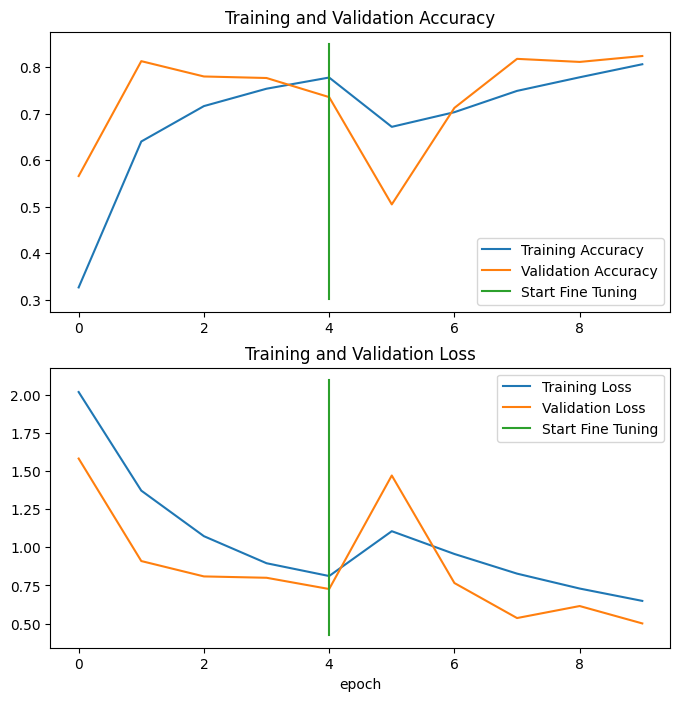

In [56]:
compare_history(history_2, history_4)

## Viewing Experiments in Tensorboard

`⚠️ WARNING`: Do not use tensorboard when using private datasets or models. Tensorboard make them public.

In [60]:
%load_ext tensorboard

In [66]:
%tensorboard --logdir_spec=name_1:/content/tb_callback/exp_1,name_2:/content/tb_callback/exp_2,name_3:/content/tb_callback/exp_3,name_4:/content/tb_callback/exp_4

<IPython.core.display.Javascript object>